# **NeuralDEM Hopper Tutorial**



This tutorial will show you how to:
- setup an environment and the data for a NeuralDEM hopper inference rollout
- visualize the data
- preprocess the data
- model inference rollout
- visualize model predictions against ground truth

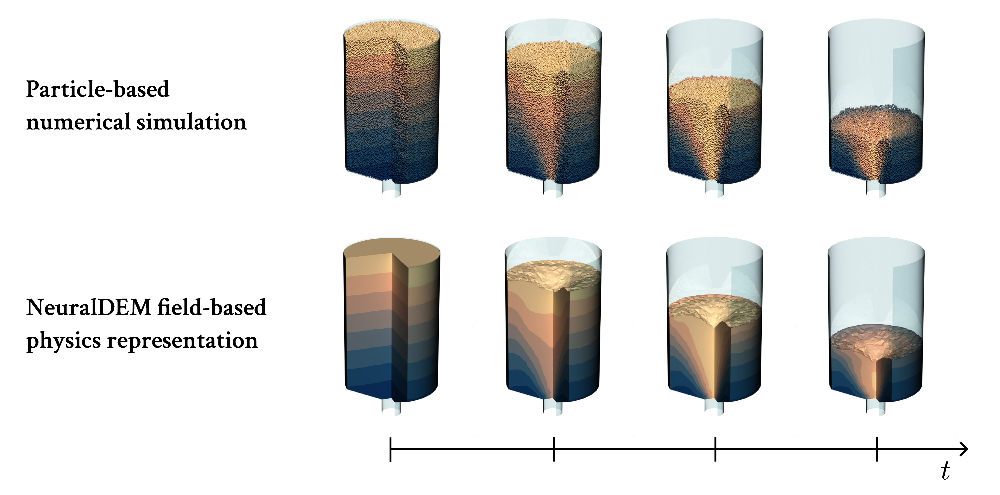

# Setup and imports


The notebook was developed and tested with torch==2.6.0+cu124.

## Setup environment

In [1]:
!pip install torch_geometric
!pip install huggingface_hub
!pip install pyg_lib torch_scatter torch_cluster -f https://data.pyg.org/whl/torch-2.6.0+cu124.html

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 31.0 MB/s eta 0:00:00
Looking in links: https://data.pyg.org/whl/torch-2.6.0+cu124.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 26.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 87.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 107.4 MB/s eta 0:00:00


In [2]:
from tqdm import tqdm
from pathlib import Path
from IPython.display import HTML, Image
from base64 import b64encode
from huggingface_hub import hf_hub_download

import ast
import einops
import h5py
import torch
from torch_geometric.nn.pool import knn
torch.manual_seed(0)

## Setup NeuralDEM code

In [3]:
!git clone https://github.com/Emmi-AI/NeuralDEM.git

Cloning into 'NeuralDEM'...
remote: Enumerating objects: 302, done.
remote: Total 302 (delta 0), reused 0 (delta 0), pack-reused 302 (from 2)
Receiving objects: 100% (302/302), 271.06 MiB | 23.22 MiB/s, done.
Resolving deltas: 100% (83/83), done.


In [4]:
%cd NeuralDEM/src

/content/NeuralDEM/src


In [5]:
from neural_dem import HopperModel
from neural_dem.utils import plotting_utils, logscale

## Download data

Download a single simulation from the testset. The full dataset has ~1TB and would take a while to download.

In [6]:
hf_hub_download(
    repo_id="EmmiAI/NeuralDEM",
    filename="data/000924_6222c92e3bf70.h5",
    local_dir="./",
)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


000924_6222c92e3bf70.h5:   0%|          | 0.00/1.31G [00:00<?, ?B/s]

'data/000924_6222c92e3bf70.h5'

# Load and visualize data

Let's visualize the simulation. The considered setting is a cylindric hopper filled with particles and an outlet at the bottom where particles gradually flow out. A full 3D rendered visualization would look like this:

In [7]:
mp4 = open("../docs/static/videos/hopper_videos/hopper122_cropped.mp4", "rb").read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""<video width=600 controls><source src="%s" type="video/mp4"></video>""" % data_url)

For simplicity, we will inspect data/results by inspecting the 2D center slice. Which we will visualize in the following sections.

## Load DEM data

We precomputed the gif above, as even the 2D visualization can be slow to generate. To generate a gif on your own, we will now load the data, which we can then later also use to compare the model predictions against.

In [8]:
# load data from the DEM simulation
import ast
position = []
displacement = []
identifier = []
# load data from h5
with h5py.File("./data/000924_6222c92e3bf70.h5", "r") as f:
    num_timesteps = len([key for key in f.keys() if key.isdigit()])
    for timestep in range(num_timesteps):
        timestep_data = f[f"{timestep:06d}"]
        position.append(torch.from_numpy(timestep_data["position"][()]))
        displacement.append(torch.from_numpy(timestep_data["displacement"][()]))
        identifier.append(torch.from_numpy(timestep_data["identifier"][()]))
    padded_transport = torch.from_numpy(f["transport"][()])
    padded_residence = torch.from_numpy(f["residence_time"][()])
    # load scalar simulation inputs
    parameters = ast.literal_eval(f["parameters"][()].decode("utf-8"))
    geometry_angle = parameters["alphaDeg"]
    mupp = parameters["mupp"]
    rfpp = parameters["rfpp"]

## Generate auxiliary fields

We train a model to additionally predict macroscopic properties (transport, residence, occupancy) of the simulation. This enables us to formulate the task as a field learning problem to learn macroscopic insights ("how particle masses move around") instead of focusing on microscopic details of the simulation ("how each individual particle moves around").

All of these auxiliary macroscopic properties are generated from nothing else but the DEM data. Practitioners could obtain these values by postprocessing the DEM data. With NeuralDEM, we can directly learn these fields instead of learning the microscopic properties (particle position/displacement).

### Transport

The transport is the integrated particle displacement/velocity from t=0 to the current timestep. This can be easily generated by assigning ids to each particle and storing these ids at every timestep. With this id, we can look up the initial position of each particle, which will be the target value for the NeuralDEM hopper model. The transport prediction task is formulated as "What is the initial position of particles at this location?"

This field can be used to obtain insights into flow behavior.

In [9]:
# generate transport
transport = []
for timestep in range(num_timesteps):
    transport.append(padded_transport[identifier[timestep]])

### Residence time

The residence time describes how long a particle resides within the hopper. Intuitively, this is interesting e.g., in the food industry when food is mixed around. If a mixer has stale regions, food will remain in there for prolonged periods of time and might go bad.

To obtain this field, we simply tracked how long each particle resides in the hopper in the DEM simulation and use this value as target. The task then is "How long will this particle reside in the hopper?"

In [10]:
# generate residence
residence = []
for timestep in range(num_timesteps):
    residence.append(padded_residence[identifier[timestep]])

### Occupancy

As the NeuralDEM hopper model predicts exclusively fields, it does not have a notion of particle positions and can be evaluated at arbitrary positions. However, positions outside the domain or in empty regions of the hopper will produce garbage as the model has not been trained to produce predictions for these settings. Therefore, we need some way to know at which positions it makes sense to evaluate the model. To do this, we learn an occupancy field, which is a binary clasification task that can be intuitively described as "Is this position occupied with a particle or not?"

Later on, we can query the occupancy field at arbitrary positions (e.g., positions from an evenly spaced regular grid of the domain or the particle positions at t=0) to get the outline of the hopper geometry and the current filling state of the hopper (i.e., "where is mass and where is air").

To generate this field, we define a radius around each particle position and deem this area as occupied. In a densly packed mass of particles there is inherently some space that is filled with air. To account for that, we choose the occupancy radius to be roughly twice as large as the particle radius.

In [11]:
def sample_random_positions_in_domain(num_positions: int) -> torch.Tensor:
    # sample random positions in domain
    random_positions = torch.rand(size=(num_positions, 3))
    # scale to domain of hopper
    random_positions = (raw_pos_max - raw_pos_min) * random_positions + raw_pos_min
    # we rescale positions to [0, 1000] for positional embeddings so we also do occupancy on that scale
    random_positions = (random_positions - raw_pos_min) / (raw_pos_max - raw_pos_min) * pos_scale
    return random_positions

# generate occupancy
num_occupancy_pos = 250_000
occupancy_radius = 10.0
occupancy_pos = []
occupancy_value = []
# min/max normalization normalize positions (i.e, hopper is ~0.28 in x/y and ~0.48 in z)
raw_pos_min = torch.tensor([[-0.14, -0.14, -0.04]])
raw_pos_max = torch.tensor([[+0.14, +0.14, +0.44]])
# aspect-preserving scale (the 1.6666 comes from the hopper height being roughly 5/3 times as large as width/depth)
pos_scale = torch.tensor([1000, 1000, 1000 * 1.6666])
for timestep in tqdm(range(num_timesteps)):
    # sample random positions in domain
    random_pos = sample_random_positions_in_domain(num_positions=num_occupancy_pos)
    # particle locations are occupied positions -> check if random pos are in vicinity of occupied positions
    occupied_pos = (position[timestep] - raw_pos_min) / (raw_pos_max - raw_pos_min) * pos_scale
    nn_idx = knn(x=occupied_pos, y=random_pos, k=1, cosine=False).cpu()
    delta = (occupied_pos[nn_idx[1]] - random_pos[nn_idx[0]]).norm(dim=1)
    is_occupied = (delta < occupancy_radius).float()
    # map positions back to unnormalized domain
    random_pos = random_pos / pos_scale * (raw_pos_max - raw_pos_min) + raw_pos_min
    # append
    occupancy_pos.append(random_pos)
    occupancy_value.append(is_occupied)

100%|██████████| 323/323 [05:11<00:00,  1.04it/s]


### Visualization

Now we have all the data that we need, lets visualize some timesteps to see how the simulation evolves over time.
- Initially (timestep 0), we see a full hopper with nicely layered transport (we bin the transport into 8 bins along the z dimension for nice visualization) as particles have not moved yet. The residence time vaguely visualizes how particles move out, as particles with low residence time will move out first and high residence time particles will exit the hopper last.
- As the simulation progresses, the number of occupied positions gets lower and lower, as particles exit the hopper. The initially nicely aligned layers of the z-binned transport gradually deform depending on the flow regime.

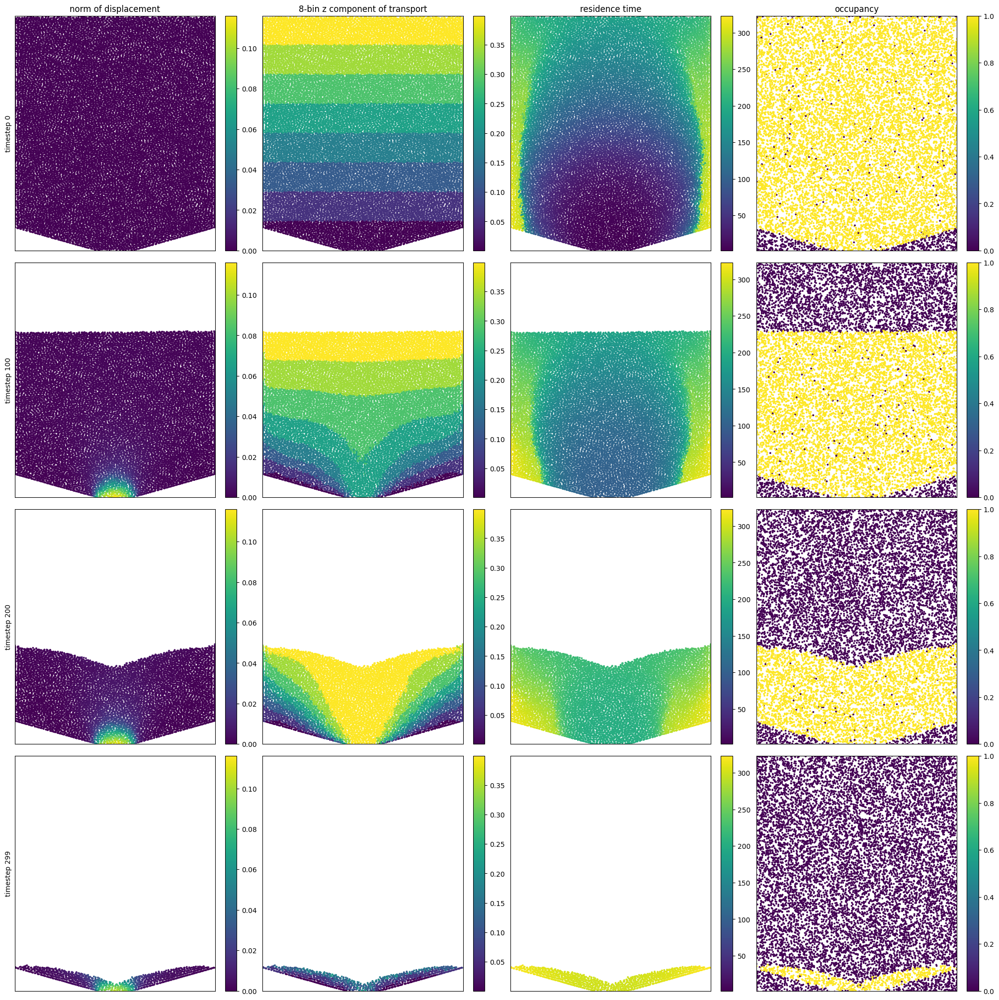

In [13]:
# plot 4 timesteps
timesteps_to_plot = [0, 100, 200, 299]
plotting_utils.plot_hopper_timesteps(
    displacement_pos=position,
    displacement_value=displacement,
    transport_pos=position,
    transport_value=transport,
    residence_pos=position,
    residence_value=residence,
    occupancy_pos=occupancy_pos,
    occupancy_value=occupancy_value,
    timesteps=timesteps_to_plot,
    num_transport_bins=8,
)

# NeuralDEM hopper model

We now have loaded the data and inspected it, lets see how our model performs in comparison.

We first instantiate the model using a pre-trained checkpoint and then create predictions for each timestep of the simulation.

In [14]:
# download the checkpoint
hf_hub_download(
    repo_id="EmmiAI/NeuralDEM",
    filename="models/hopper.th",
    local_dir="./",
)

hopper.th:   0%|          | 0.00/201M [00:00<?, ?B/s]

'models/hopper.th'

In [15]:
# instantiate model and load weights
model = HopperModel().eval()
model.load_state_dict(torch.load("./models/hopper.th", weights_only=True))
model = model.to("cuda")

We sample uniform positions from the whole domain as query points to obtain predictions. For simplicity, we query all fields and later remove the non-occupied predictions. The inference could be sped up by first evaluating only the occupancy and then evaluating the other fields only on occupied positions.

To make it faster, you can reduce the resolution (`num_positions`). As we sample from the whole domain, but only visualize the center slice, we use a quite large resolution here to get nice visualizations. However, performance is not tied to resolution, so you could also do this with much lower resolution (e.g., try out `50_000` instead of `500_000`).

An even faster way to obtain nice visualizations would be to query only points in the center plane (i.e., the plane that is visualized). However, as in practice, you'd want to query the whole domain, we showcase querying the full 3D space here.

In [18]:
# on which positions to evaluate? e.g., by evaluating at random locations in the domain
torch.manual_seed(0)
random_pos = sample_random_positions_in_domain(num_positions=500_000).unsqueeze(0).to("cuda")
# run inference on same timesteps as plotted for a side-by-side comparison
predictions = []
for timestep in tqdm(range(num_timesteps)):
    with torch.inference_mode():
        with torch.autocast(device_type="cuda", dtype=torch.bfloat16):
            prediction = model(
                # inputs
                timestep=timestep,
                geometry_angle=geometry_angle,
                mupp=mupp,
                rfpp=rfpp,
                # output positions
                output_displacement_pos=random_pos,
                output_occupancy_pos=random_pos,
                output_transport_pos=random_pos,
                output_residence_pos=random_pos,
            )
            predictions.append(prediction)

100%|██████████| 323/323 [17:23<00:00,  3.23s/it]


In [19]:
# remove predictions of unoccupied positions and denormalize predictions
transport_mean = torch.tensor([0.0, 0.0, 0.2])
transport_std = torch.tensor([0.0616, 0.0616, 0.0741])
displacement_mean = torch.tensor([0.0, 0.0, 0.0])
displacement_std = torch.tensor([0.0009, 0.0009, 0.0057])
for prediction in tqdm(predictions):
    is_occupied = (prediction["occupancy"] > 0).squeeze(1)
    prediction["random_pos"] = random_pos.squeeze(0)
    prediction["occupied_pos"] = random_pos.squeeze(0)[is_occupied]
    prediction["displacement"] = prediction["displacement"][is_occupied]
    prediction["transport"] = prediction["transport"][is_occupied]
    prediction["residence"] = prediction["residence"][is_occupied]
    # map position back to denormalized space
    prediction["random_pos"] = prediction["random_pos"].cpu() / pos_scale * (raw_pos_max - raw_pos_min) + raw_pos_min
    prediction["occupied_pos"] = prediction["occupied_pos"].cpu() / pos_scale * (
            raw_pos_max - raw_pos_min) + raw_pos_min
    prediction["transport"] = prediction["transport"].cpu() * transport_std + transport_mean
    # residence time is normalized to [-1, 1] for every simulation
    prediction["residence"] = (prediction["residence"].cpu().float() + 1) / 2 * (num_timesteps - 1)
    # displacement is normalized by mean/std and converted to logscale
    prediction["displacement"] = logscale.from_logscale(
        prediction["displacement"]
        ).cpu() * displacement_std + displacement_mean


100%|██████████| 323/323 [00:11<00:00, 27.71it/s]


## Inspect results

Now we have our predictions and we can compare it against the ground truth (i.e., the DEM simulation)

### Occupancy

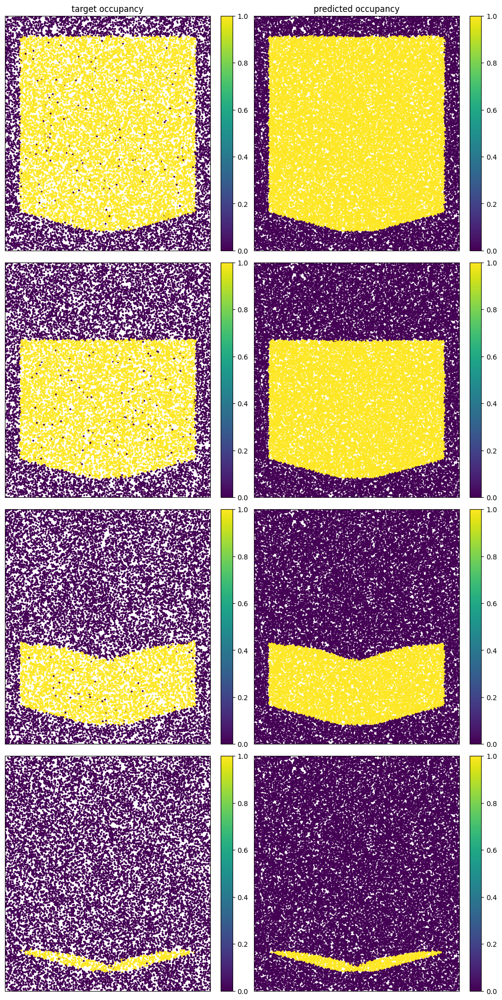

In [20]:
plotting_utils.plot_hopper_predictions_randompos(
    target=[occupancy_value[t] for t in timesteps_to_plot],
    target_pos=[occupancy_pos[t] for t in timesteps_to_plot],
    prediction=[(predictions[t]["occupancy"].cpu().squeeze(1) > 0).float() for t in timesteps_to_plot],
    prediction_pos=[predictions[t]["random_pos"].cpu().squeeze(0) for t in timesteps_to_plot],
    name="occupancy",
)

### Displacemment


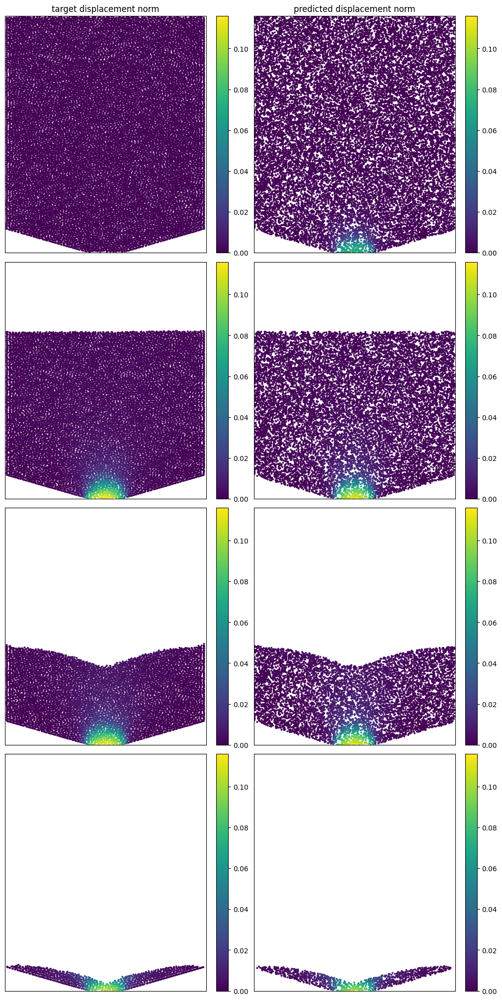

In [22]:
plotting_utils.plot_hopper_predictions_randompos(
    target=[displacement[t].norm(dim=1) for t in timesteps_to_plot],
    target_pos=[position[t] for t in timesteps_to_plot],
    prediction=[predictions[t]["displacement"].norm(dim=1).cpu() for t in timesteps_to_plot],
    prediction_pos=[predictions[t]["occupied_pos"].cpu() for t in timesteps_to_plot],
    name="displacement norm",
)

### Transport

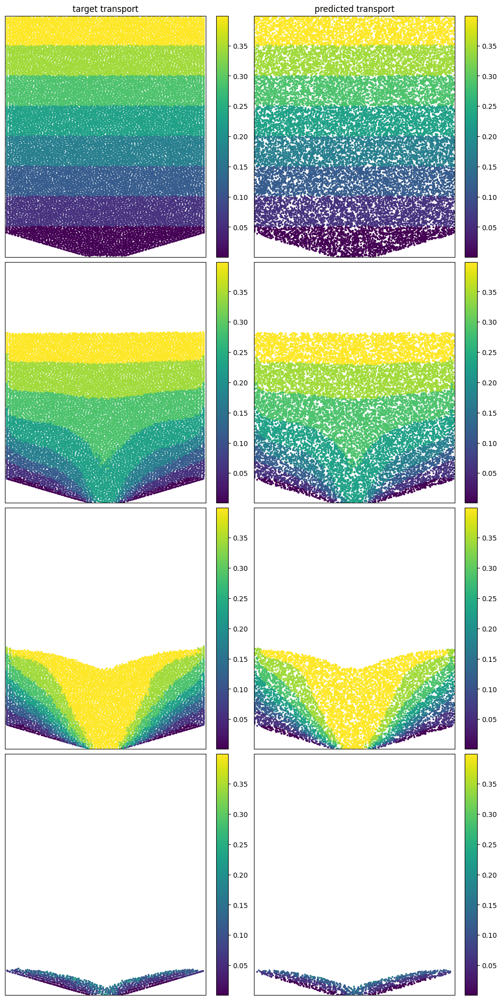

In [23]:
plotting_utils.plot_hopper_predictions_randompos(
    target=[transport[t][:, 2] for t in timesteps_to_plot],
    target_pos=[position[t] for t in timesteps_to_plot],
    prediction=[predictions[t]["transport"][:, 2].cpu() for t in timesteps_to_plot],
    prediction_pos=[predictions[t]["occupied_pos"].cpu() for t in timesteps_to_plot],
    name="transport",
    num_bins=8,
)

### Residence time

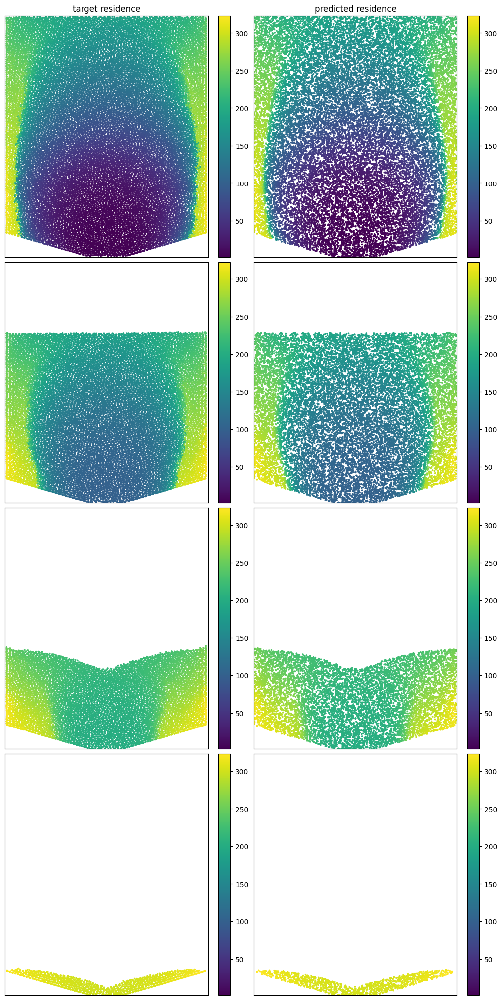

In [25]:
plotting_utils.plot_hopper_predictions_randompos(
    target=[residence[t] for t in timesteps_to_plot],
    target_pos=[position[t] for t in timesteps_to_plot],
    prediction=[predictions[t]["residence"].squeeze(1).cpu() for t in timesteps_to_plot],
    prediction_pos=[predictions[t]["occupied_pos"].cpu() for t in timesteps_to_plot],
    name="residence",
)